### 更新：该脚本主要记录了模型搭建的思路，不是最新的训练脚本

In [13]:
import mxnet as mx
from mxnet.gluon import nn
from mxnet import gluon,nd
from mxnet.gluon.model_zoo import vision
from mxnet.gluon import Block, HybridBlock
import numpy as np
import matplotlib.pyplot as plt
import pdb
import time 
from mxnet import autograd

## Step 1: 

定义yolo-v2网络模型：先使用resnet的前6个block（深度256->256, 输入256x256，输出16x16）, 进行特征提取;  
再将256x16x16特征送入一层输出通道数为2x(num_classes+1+4) = 14，(1x1)的卷积层，得到最终的14 x 16 x 16维度输出

In [14]:
def yolo_v2_net(num_classes, anchor_scales):
    # resnet18前6个block
    pretrained = vision.get_model('resnet18_v1', pretrained=True).features
    net = nn.HybridSequential()
    for i in range(len(pretrained)-2):
        net.add(pretrained[i])
    # 最后一个卷积层
    predictor = Yolo2_Output(num_classes=2, anchor_scales=anchor_scales)
    predictor.initialize()
    net.add(predictor)
    return net

In [15]:
class Yolo2_Output(HybridBlock):
    def __init__(self, num_classes, anchor_scales):
        super(Yolo2_Output, self).__init__()
        assert len(anchor_scales)>0, "at least one anchor scale required"
        assert num_classes>0, "num of class should >0, given{}".format(num_classes)
        self._anchor_scales = anchor_scales
        output_channel = len(anchor_scales) * (num_classes + 1 + 4)
        with self.name_scope():
            self.output = nn.Conv2D(output_channel,1,1)
    def hybrid_forward(self,F,x):
        return self.output(x)

check result: 任意取两个scale进行前向传播，检查维度

In [16]:
test_scales = [[3.3004,3.59034],
               [9.84923, 8.23783]]
net = yolo_v2_net(num_classes=2, anchor_scales=test_scales)
test_input = nd.ones(shape = [16,3,256,256])
test_output = net(test_input)
print('经前向传播之后的输出维度为: {}'.format(test_output.shape))

经前向传播之后的输出维度为: (16, 14, 16, 16)


## Step 2:

定义一个函数，从网络输出的特征中分离出信息：每个grid cell中每个bbox的 ①class_prediction②score③bbox信息  

In [17]:
#这两个helper function不是自己写的，需要日后详细研究
def transform_center(xy):
    """Given x, y prediction after sigmoid(), convert to relative coordinates (0, 1) on image."""
    b, h, w, n, s = xy.shape
    offset_y = nd.tile(nd.arange(0, h, repeat=(w * n * 1), ctx=xy.context).reshape((1, h, w, n, 1)), (b, 1, 1, 1, 1))
    # print(offset_y[0].asnumpy()[:, :, 0, 0])
    offset_x = nd.tile(nd.arange(0, w, repeat=(n * 1), ctx=xy.context).reshape((1, 1, w, n, 1)), (b, h, 1, 1, 1))
    # print(offset_x[0].asnumpy()[:, :, 0, 0])
    x, y = xy.split(num_outputs=2, axis=-1)
    x = (x + offset_x) / w
    y = (y + offset_y) / h
    return x, y
def transform_size(wh, anchors):
    """Given w, h prediction after exp() and anchor sizes, convert to relative width/height (0, 1) on image"""
    b, h, w, n, s = wh.shape
    aw, ah = nd.tile(nd.array(anchors, ctx=wh.context).reshape((1, 1, 1, -1, 2)), (b, h, w, 1, 1)).split(num_outputs=2, axis=-1)
    w_pred, h_pred = nd.exp(wh).split(num_outputs=2, axis=-1)
    w_out = w_pred * aw / w
    h_out = h_pred * ah / h
    return w_out, h_out

In [20]:
def yolo2_feature_spliter(feature, num_classes, anchor_scales):
    '''
    Transpose/Reshape/Organize convolution outputs.
    '''
    stride = num_classes + 5
    feature = nd.transpose(feature,[0,2,3,1])  #(32,16,16,14)
    feature = feature.reshape((0,0,0,-1,stride))   #(32,16,16,2,7)
    # class probs
    cls_pred = feature.slice_axis(begin=0, end=num_classes, axis=-1)
    # object score
    score_pred = feature.slice_axis(begin=num_classes, end=num_classes+1, axis=-1)
    scores = nd.sigmoid(score_pred)
    # center prediction, in range(0,1) for each grid
    xy_pred = feature.slice_axis(begin=num_classes+1, end=num_classes+3, axis=-1)
    xy = nd.sigmoid(xy_pred)
    #pdb.set_trace()
    # 注意：此时的每个grid的中心坐标(x,y)表示的是位于当前grid cell的相对位置, 在最后预测阶段使用的是相对于全图的位置
    x, y = transform_center(xy)
    
    # width/height prediction
    wh = feature.slice_axis(begin=num_classes+3, end=num_classes+5, axis=-1)
    # 同理，在后面的预测阶段需要将长度和宽度转换为相对于全图的长、宽
    #pdb.set_trace()
    w, h = transform_size(wh, anchor_scales)
    
    # final class prediction
    category = nd.argmax(cls_pred, axis=-1, keepdims=True)
    
    # 注意：训练阶段使用的是【中心+长宽】的bbox，而最终预测阶段使用的思【左上角+右下角】的bbox，故提前准备好预测使用的bbox(都是相对全图的坐标)
    # 注意：一个细节：某些预测bbox的中心坐标可能位于图像边缘，且长宽已超出边界。这样当转换为corner坐标会出现负的或大于1.
    left = nd.clip(x-w/2, 0, 1)
    top = nd.clip(y-h/2, 0, 1)
    right = nd.clip(x+w/2, 0, 1)
    bottom = nd.clip(y+h/2, 0, 1)
    
    output_to_draw = nd.concat(category, scores, left, top, right, bottom, dim=-1)
    #output_to_draw = nd.concat(*[category, scores, left, top, right, bottom], dim=-1)
    # 注意：这里必须加星号。否则 mxnet AssertionError: Positional arguments must have NDArray type, but got [...
    return output_to_draw, cls_pred, scores, nd.concat(*[xy, wh], dim=-1)

check result：

In [21]:
op_to_draw, cls_pred, scores, xywh = yolo2_feature_spliter(test_output, num_classes=2, anchor_scales=test_scales)
print(op_to_draw.shape, cls_pred.shape, scores.shape, xywh.shape)

(16, 16, 16, 2, 6) (16, 16, 16, 2, 2) (16, 16, 16, 2, 1) (16, 16, 16, 2, 4)


## Step 3:  
将label给出的信息（相对的中心坐标和宽高，以及groundtruth bbox内的目标类别），转换为如下信息：  
每个grid cell内每个bbox的：①score(label设置时只有0或1) ②category ③bbox信息 ④sample_weight(只有groundtruth bbox对应值为1) 

注意：为了计算方便，可以使用numpy计算，但是在反向传播时转换为numpy会破坏自动求导的record。因此可以使用`with autograd.pause():`处理

In [8]:
def yolo2_target(scores, labels, anchors):
    '''根据标注label，产生training targets
    label: (None,1,5)
    target_score: (None,16,16,2,1),只有groundtruth bbox所在的grid cell上交并比最大的anchor的序号对应值为1，其他所有bbox处score为0
    target_category: (None,16,16,2,1)只有groundtruth bbox所在grid cell上交并比最大的anchor的序号对应值为该gbox的真实类别，其余均为背景类
    target_box: (None,16,16,2,4)只有groundtruth bbox所在grid cell上交并比最大的anchor的序号对应的四个值不为零，用gbox四个值代替
    
    关键：找到所有groundtruth bbox对应的grid cell位置以及anchor序号（该grid中的第几个anchor）
    '''
    b,h,w,n,s = scores.shape
    anchors = np.array(anchors)  #为了后面求IoU,先转成numpy
    # 进入正题, 初始化四个全零矩阵。只要把有效的bbox对应anchor位置填上真实值，其他剩下的仍保留全零即可
    target_score = nd.zeros(shape=(b,h,w,n,1), ctx = scores.context)
    target_category = nd.zeros(shape=(b,h,w,n,1), ctx= scores.context)
    target_box = nd.zeros(shape=(b,h,w,n,4), ctx=scores.context)
    sample_weights = nd.zeros(shape=(b,h,w,n,1), ctx=scores.context)
    
    # 对所有batch中的每张图像的所有groundtruth bbox进行遍历，找到其各自对应的grid cell位置以及anchor序号
    for b in range(scores.shape[0]):
        label = labels[b].asnumpy()  #注意：每张图像中可能有多个labels。需要对所有labels进行遍历
        np.random.shuffle(label)
        for l in label:
            gx,gy,gw,gh = (l[1]+l[3])/2, (l[2]+l[4])/2, l[3]-l[1], l[4]-l[2]
            ind_x = int(gx * w)
            ind_y = int(gy * h)
            tx = gx * w - ind_x
            ty = gy * h - ind_y
            # 得出groundtruth bbox在16x16 feature map上的绝对尺寸
            gw = gw * w
            gh = gh * h
            # vectorized intersect: 计算简易版本交并比：假设中心坐标重合
            intersect = np.minimum(anchors[:,0], gw) * np.minimum(anchors[:,1], gh)
            ious = intersect / (anchors[:,0]*anchors[:,1] + gw * gh - intersect)  # 利用广播
            # 获得了anchor的序号
            best_match = int(np.argmax(ious))
            target_score[b,ind_y,ind_x,best_match,:] = 1.0
            target_category[b,ind_y,ind_x,best_match,:] = l[0]
            # 注意：label的bbox，即最终预测时用的bbox信息，不是网络直接预测出的关于grid的offset直接推出的，
            # 而是对offset(tx,ty)以及距离聚类中心的offset（tw,th）进行简单的运算得到的。故训练时要先根据label中的值倒推出tx,ty,tw,th
            tw = np.log(gw / anchors[best_match, 0])
            th = np.log(gh / anchors[best_match, 1])
            # 得到训练目标——bbox坐标信息
            target_box[b,ind_y,ind_x,best_match,:] = [tx, ty, tw, th]
            sample_weights[b,ind_y,ind_x,best_match,:] = 1.0
    return target_category, target_score, target_box, sample_weights

check result:

In [9]:
test_labels = nd.random_uniform(0,1,shape=[16,1,5])
test_labels[:,:,0] = 0
target_category, target_score, target_box, sample_weights = yolo2_target(scores, test_labels, test_scales)
print(target_category.shape, target_box.shape, sample_weights.shape)

(16, 16, 16, 2, 1) (16, 16, 16, 2, 4) (16, 16, 16, 2, 1)


c:\users\chengyuan.yang\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in log
c:\users\chengyuan.yang\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log


## Step 4:  
定义加载数据集的iterator函数   
* 核心：image.ImageDetIter: 专门用于目标检测任务的DateIter,提供了许多种数据增强的选项

In [13]:
def get_iterators(data_shape, batch_size):
    class_name = ['hand','dummy']
    num_classes = 2
    train_iter = mx.image.ImageDetIter(
        batch_size=batch_size,
        data_shape=(3, data_shape, data_shape),
        path_imgrec='train.rec',
        path_imgidx='train.idx',
        shuffle=True,
        mean=True,
        std=True,
        rand_crop=0,
        rand_mirror = True,
        rand_gray = 0.3,
        saturation = 0.125,
        contrast = 0.125,
        brightness = 0.125,
        pca_noise = 0.05
    )
    val_iter = mx.image.ImageDetIter(
        batch_size=batch_size,
        data_shape=(3, data_shape, data_shape),
        path_imgrec='val.rec',
        shuffle=False,
        mean=True,
        std=True)
    return train_iter, val_iter, class_name, num_classes

* check result:  
①检查生成的rec文件是否有问题

D:\第二批数据集\地平线\Binary_Detection_Dataset\Rec_dataset
(4, 3, 256, 256)
(4, 1, 5)


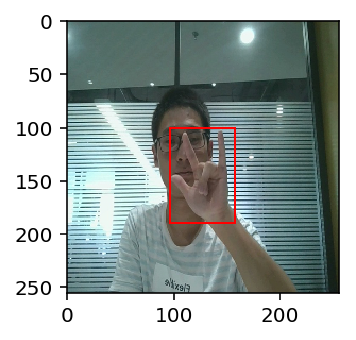

In [11]:
from utils.viz import *
from utils.check_rec import *
data_dir = r'D:\第二批数据集\地平线\Binary_Detection_Dataset\Rec_dataset'
check_rec_file(1, data_dir)

②检查get_iterators函数生成的数据，以及数据增强的效果

In [14]:
import sys
batch_size = 16
data_shape = 256
sys.path.append(data_dir)
train_data, test_data, class_names, num_class = get_iterators(data_shape, batch_size)

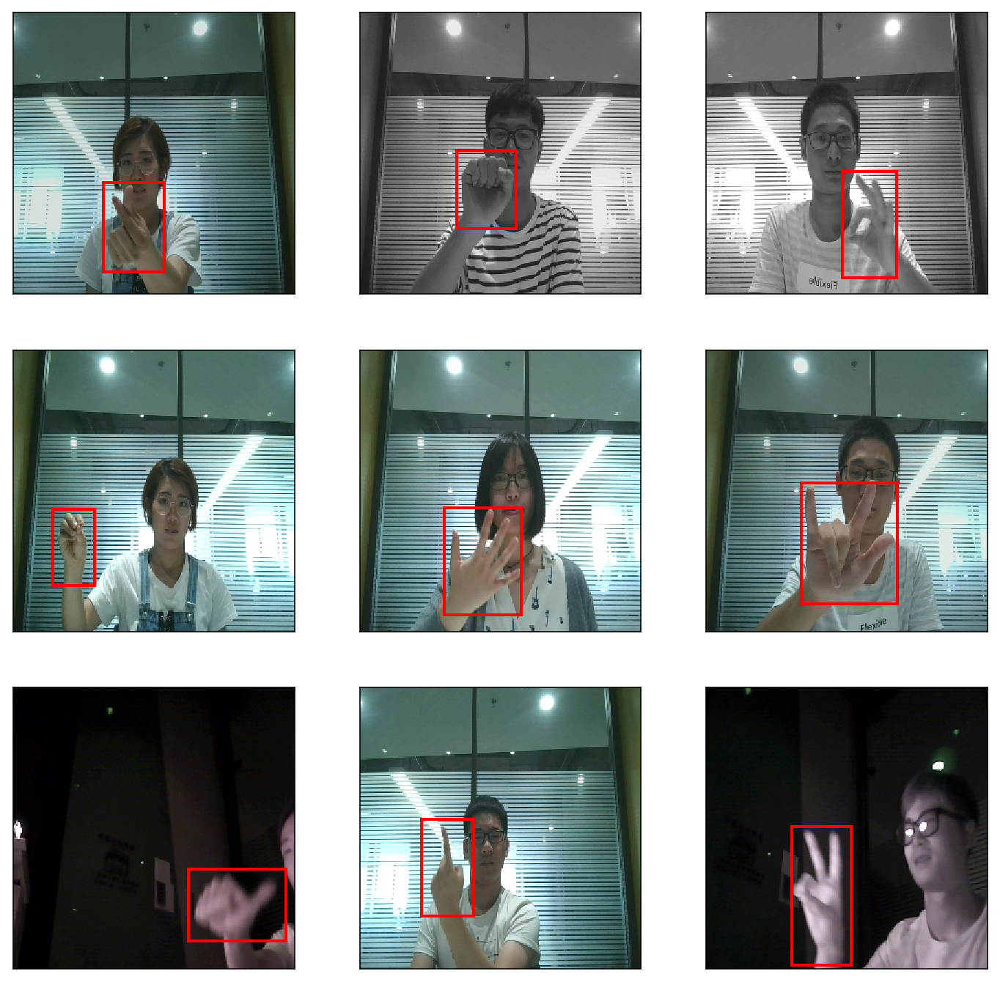

In [15]:
def box_to_rect(box, color, linewidth=3):
    """convert an anchor box to a matplotlib rectangle"""
    box = box.asnumpy()
    return plt.Rectangle(
        (box[0], box[1]), box[2]-box[0], box[3]-box[1],
        fill=False, edgecolor=color, linewidth=linewidth)

batch = train_data.next()
_, figs = plt.subplots(3, 3, figsize=(12,12))
for i in range(3):
    for j in range(3):
        img, labels = batch.data[0][3*i+j], batch.label[0][3*i+j]
        img = img.transpose((1, 2, 0)) * rgb_std + rgb_mean
        img = img.clip(0,255).asnumpy()/255
        fig = figs[i][j]
        fig.imshow(img)
        for label in labels:
            rect = box_to_rect(label[1:5]*data_shape,'red',2)
            fig.add_patch(rect)
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
plt.show()

## Step5:   
设置anchor scales，并进行最终验证

In [16]:
anchor_scales = [[3.2,5.6],[4,4],[5.6,3.2]]
imgs, labels = batch.data[0], batch.label[0]
print('dataset size:',imgs.shape, labels.shape)
net = yolo_v2_net(num_classes=2, anchor_scales=anchor_scales)
op_features = net(imgs)
print('output_features: ',op_features.shape)
output, cls_pred, scores, xywh = yolo2_feature_spliter(op_features, num_classes=2, anchor_scales=anchor_scales)
print('splited features size: ', output.shape, cls_pred.shape, scores.shape, xywh.shape)
tid, tscore, tbox, sample_weight = yolo2_target(scores, labels, anchor_scales)
print('targets size:',tid.shape,tscore.shape, tbox.shape, sample_weight.shape)

dataset size: (16, 3, 256, 256) (16, 1, 5)
output_features:  (16, 21, 16, 16)
splited features size:  (16, 16, 16, 3, 6) (16, 16, 16, 3, 2) (16, 16, 16, 3, 1) (16, 16, 16, 3, 4)
targets size: (16, 16, 16, 3, 1) (16, 16, 16, 3, 1) (16, 16, 16, 3, 4) (16, 16, 16, 3, 1)


## Step 6:  
定义loss函数，评测metric以及Trainer

In [17]:
# 定义softmax loss 和 l1_loss
softmax_loss = gluon.loss.SoftmaxCrossEntropyLoss(from_logits=False)
l1_loss = gluon.loss.L1Loss()

In [18]:
# 定义评测标准：直接观测损失函数是否下降
class LossRecorder(mx.metric.EvalMetric):
    def __init__(self, name):
        super(LossRecorder, self).__init__(name)
    def update(self, labels, preds=0):
        for loss in labels:
            if isinstance(loss, mx.nd.NDArray):
                loss = loss.asnumpy()
            self.sum_metric += loss.sum()
            self.num_inst += 1
obj_loss = LossRecorder('objectness_loss')
cls_loss = LossRecorder('classification_loss')
box_loss = LossRecorder('box_refine_loss')

## Step 7:  
定义训练所用函数:


In [19]:
positive_weight = 5.0
negative_weight = 0.1
class_weight = 1.0
box_weight = 5.0

In [41]:
def train(num_epochs, batch_size, learning_rate, ctx, anchors):
    ctx = mx.gpu(3)
    #ctx = mx.cpu(0)
    net.collect_params().reset_ctx(ctx)
    trainer = gluon.Trainer(params=net.collect_params(), optimizer='sgd', optimizer_params={'learning_rate':learning_rate, 'wd':5e-4})
    # get training iterator:
    train_data, test_data, class_names, num_class = get_iterators(data_shape=256, batch_size=batch_size)
    for epoch in range(num_epochs):
        # reset data iterators and metrics
        train_data.reset()
        cls_loss.reset()
        obj_loss.reset()
        box_loss.reset()
        tic = time.time()
        for i, batch in enumerate(train_data):
            x = batch.data[0].as_in_context(ctx)
            y = batch.label[0].as_in_context(ctx)
            with autograd.record():
                x = net(x)
                output, cls_pred, scores, xywh = yolo2_feature_spliter(x, num_classes=2, anchor_scales=anchors)
                with autograd.pause():
                    # 由于yolo2_target中用到了nd->np的转换，会破坏求导记录，故放到autograd.pause中使用
                    tid, tscore, tbox, sample_weights = yolo2_target(scores, labels, anchors=anchors)
                loss_clf = softmax_loss(cls_pred, tid, sample_weights * class_weight)
                # 注意下一句：非常简洁的写法，求出λ_noobj和λ_obj对应相乘之后的整体权重矩阵
                score_weight = nd.where(sample_weights > 0,
                                      nd.ones_like(sample_weights) * positive_weight,
                                      nd.ones_like(sample_weights) * negative_weight)
                loss_objectness = l1_loss(scores, tscore, score_weight)
                loss_box = l1_loss(xywh, tbox, sample_weights * box_weight)
                loss = loss_clf + loss_objectness + loss_box
            loss.backward()
            trainer.step(batch_size)
            cls_loss.update(loss_clf)
            obj_loss.update(loss_objectness)
            box_loss.update(loss_box)
            
        print('Epoch %2d, train %s %.5f, %s %.5f, %s %.5f time %.1f sec' % (
        epoch, *cls_loss.get(), *obj_loss.get(), *box_loss.get(), time.time()-tic))
        net.save_params('hand_3_anchor.params')
    #return net

## Step 8：  
定义预测所用函数

In [20]:
def creat_model(params_path, num_classes, anchor_scales):
    pretrained = vision.get_model('resnet18_v1').features
    net = nn.HybridSequential()
    for i in range(len(pretrained)-2):
        net.add(pretrained[i])
    predictor = Yolo2_Output(num_classes=num_classes, anchor_scales=anchor_scales)
    net.add(predictor)
    net.load_parameters(params_path)
    return net

In [122]:
test_batch = test_data.next()
t_x, t_y = test_batch.data[0], test_batch.label[0]
model = creat_model('F:\Softwares\Pycharm\Pycharm_local\hands_detection\yolo_v2\model_saved\hand_3_anchor_epoch_9.params',2,anchor_scales)
x = model(t_x)

<input>:3: DeprecationWarning: invalid escape sequence \S
<input>:3: DeprecationWarning: invalid escape sequence \S
<input>:3: DeprecationWarning: invalid escape sequence \S
<ipython-input-122-d022998046b8>:3: DeprecationWarning: invalid escape sequence \S
  model = creat_model('F:\Softwares\Pycharm\Pycharm_local\hands_detection\yolo_v2\model_saved\hand_3_anchor_epoch_9.params',2,anchor_scales)


In [153]:
output, cls_prob, score, xywh = yolo2_feature_spliter(x, 2, anchor_scales)
out = nd.contrib.box_nms(output.reshape((0,-1,6)))


In [23]:
RGB_MEAN = nd.array([123, 117, 104])
RGB_STD = nd.array([58.395, 57.12, 57.375])
anchor_scales = [[3.2,5.6],[4,4],[5.6,3.2]]

def process_image(fname):
    with open(fname, 'rb') as f:
        im = mx.image.imdecode(f.read())
    # resize to data_shape
    data = mx.image.imresize(im, 256, 256)
    # minus rgb mean, divide std
    data = (data.astype('float32') - RGB_MEAN) / RGB_STD
    # convert to batch x channel x height xwidth
    return data.transpose((2,0,1)).expand_dims(axis=0), im

def predict(x):
    t1 = time.time()
    x = model(x)
    print('time for one forward pass: ', (time.time()-t1)*1000, 'ms')
    output, cls_prob, score, xywh = yolo2_feature_spliter(x, 2, anchor_scales)
    return nd.contrib.box_nms(output.reshape((0, -1, 6)))

In [27]:
x, im = process_image(test_dir + test_samples[9])   #这里的data是resize之后的，im为原尺寸
model = creat_model('D:/Programs/Gluon_Tutorial/Gluon_Yolo_v2/models/anchor_num_3/anchor_num_3_99.params',2,anchor_scales)
out = predict(x.as_in_context(mx.cpu(0)))
#out[0][0:150]
out1 = out.asnumpy()

xx = nd.squeeze(x).transpose((1,2,0))
xx = (xx * rgb_mean + rgb_std).asnumpy()
xxx = xx.clip(0, 255) / 255.
plt.imshow(xxx)
box = out1[0][0][2:6] * np.array([256, 256]*2)
rect = box_to_rect(nd.array(box), 'green', 2)
plt.gca().add_patch(rect)
plt.show()

AssertionError: Failed loading Parameter 'yolo2_output3_conv0_bias' from saved params: shape incompatible expected (35,) vs saved (21,)

time for one forward pass:  6.981372833251953 ms
predictiing time for one frame:  18.94855499267578 ms


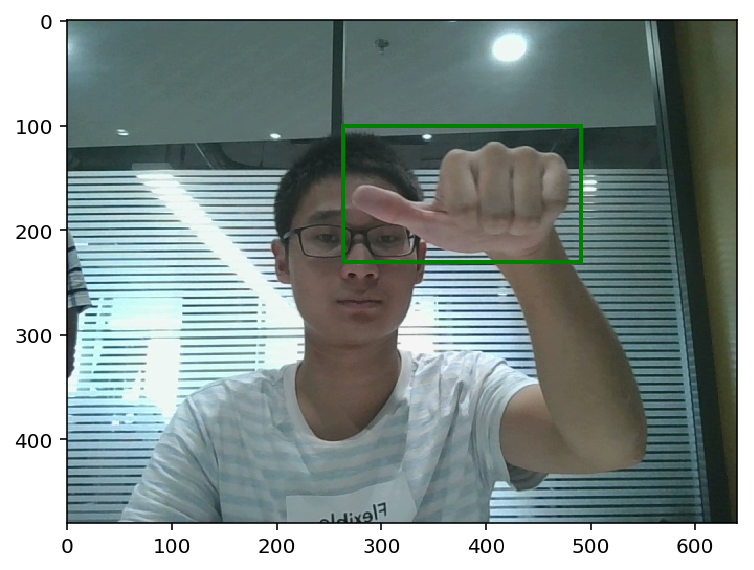

time for one forward pass:  6.98089599609375 ms
predictiing time for one frame:  19.983768463134766 ms


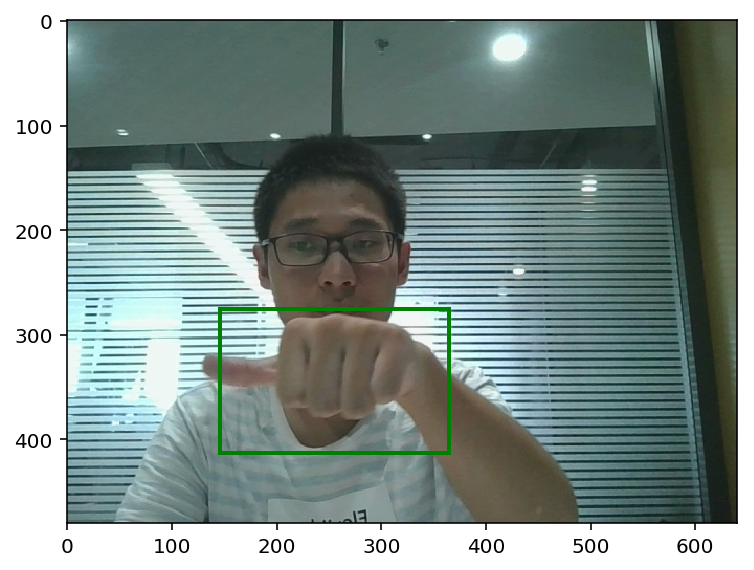

time for one forward pass:  6.981849670410156 ms
predictiing time for one frame:  15.957832336425781 ms


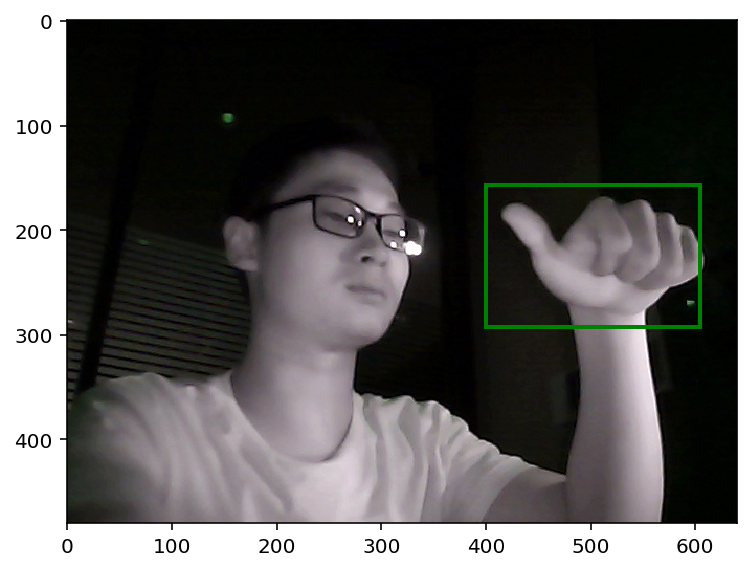

time for one forward pass:  5.984067916870117 ms
predictiing time for one frame:  16.954660415649414 ms


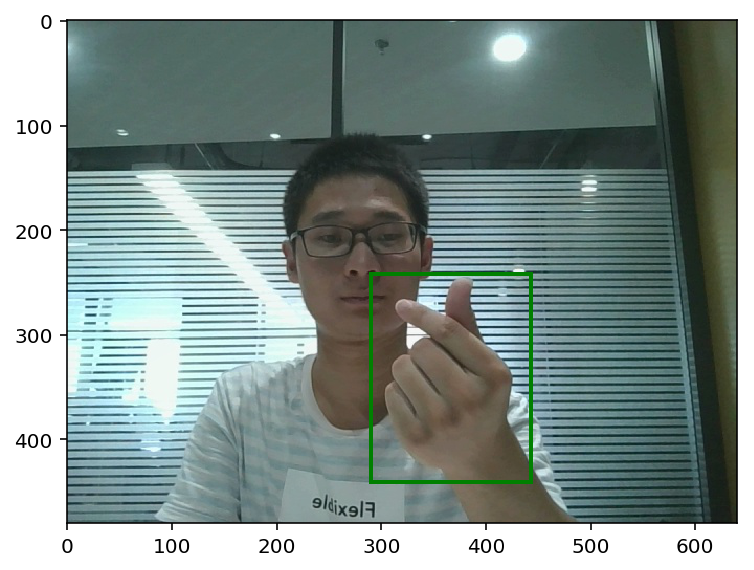

time for one forward pass:  5.985021591186523 ms
predictiing time for one frame:  21.940231323242188 ms


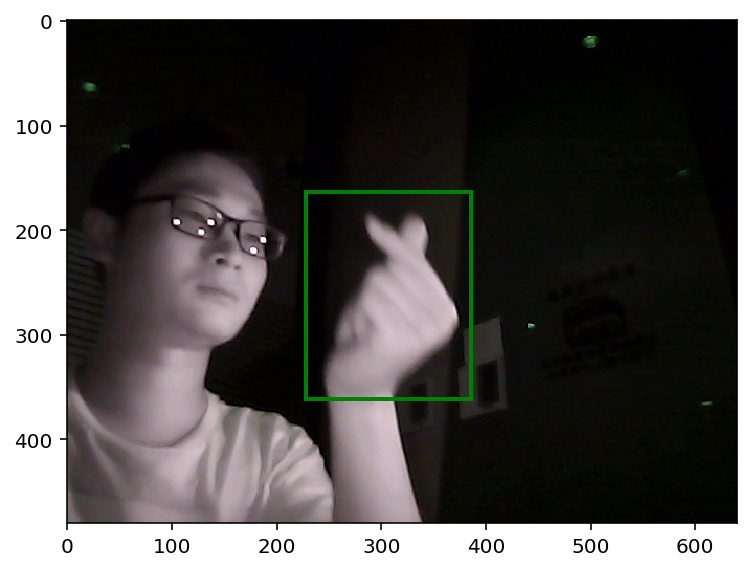

time for one forward pass:  4.987239837646484 ms
predictiing time for one frame:  20.944595336914062 ms


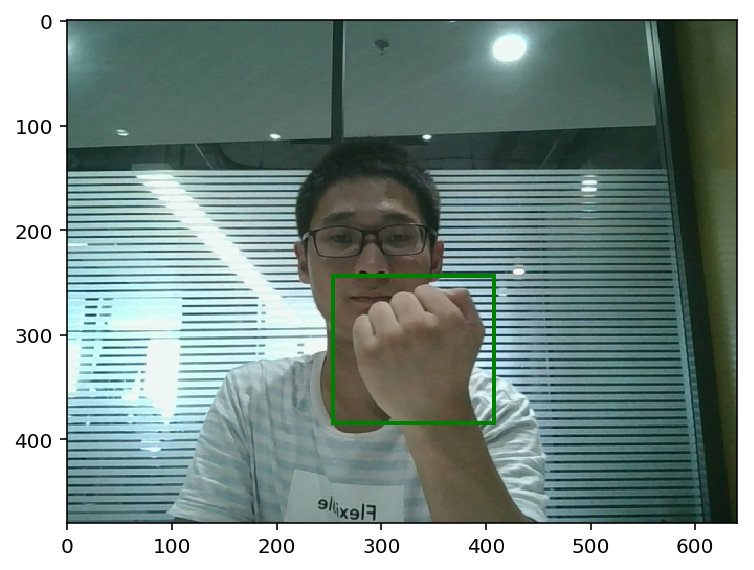

time for one forward pass:  8.010387420654297 ms
predictiing time for one frame:  22.93705940246582 ms


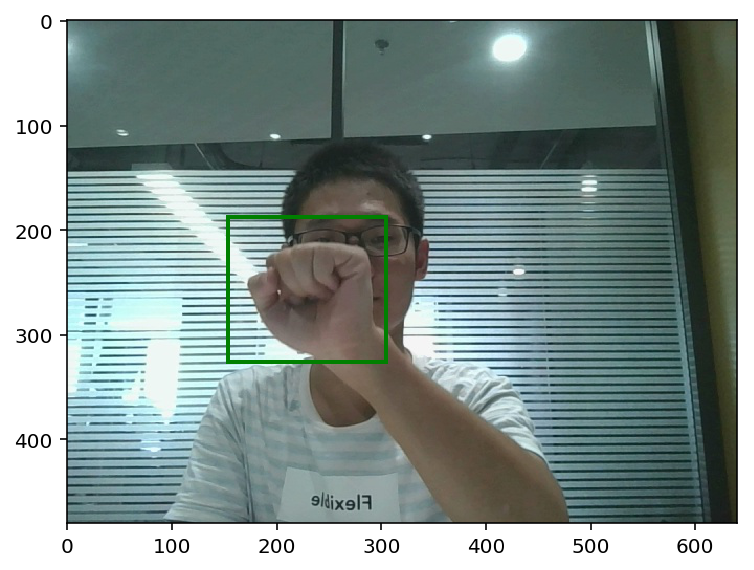

time for one forward pass:  7.980585098266602 ms
predictiing time for one frame:  20.94554901123047 ms


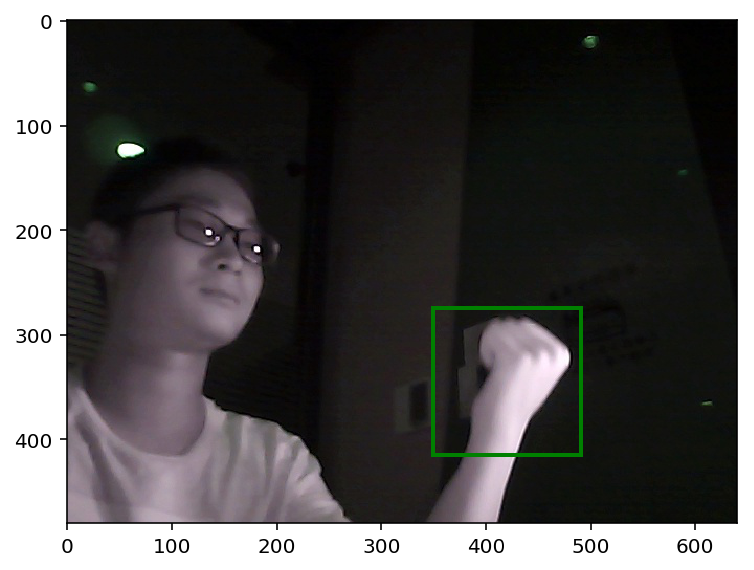

time for one forward pass:  5.984067916870117 ms
predictiing time for one frame:  21.9419002532959 ms


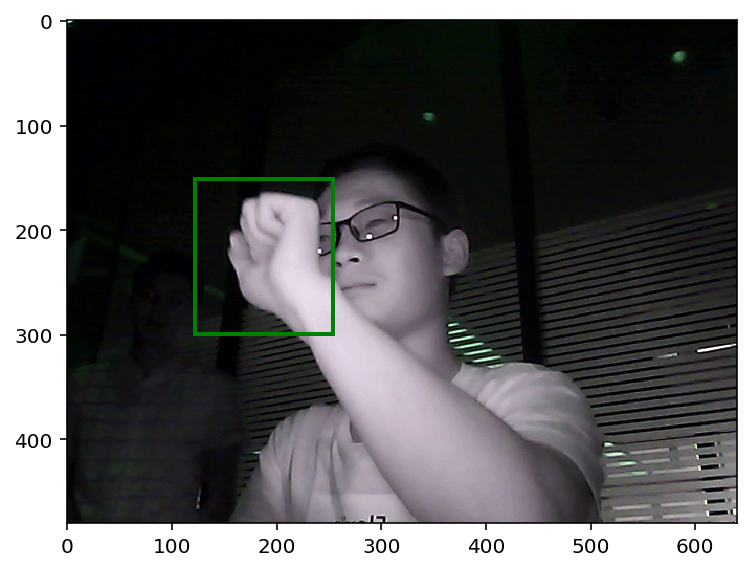

time for one forward pass:  6.98399543762207 ms
predictiing time for one frame:  19.945144653320312 ms


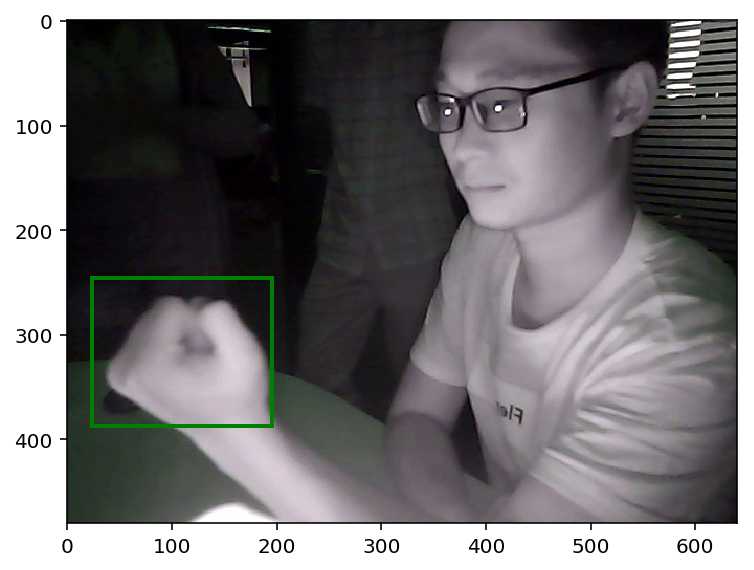

time for one forward pass:  5.983591079711914 ms
predictiing time for one frame:  18.94974708557129 ms


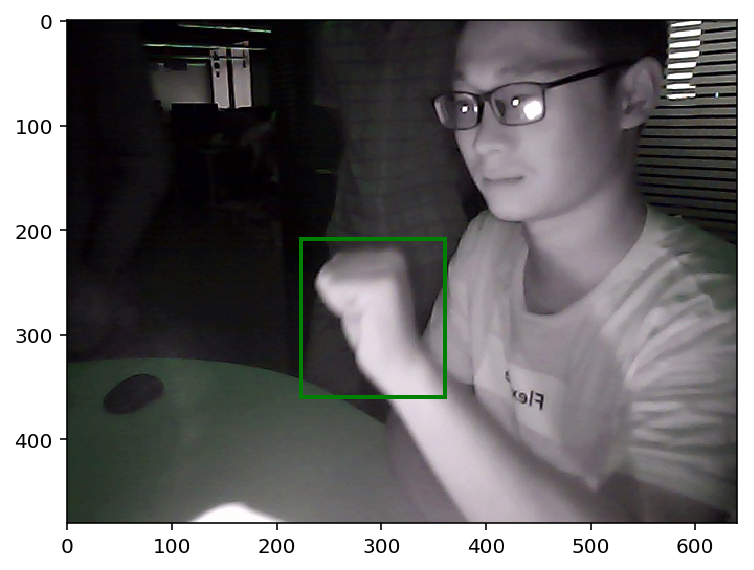

time for one forward pass:  5.985021591186523 ms
predictiing time for one frame:  19.947290420532227 ms


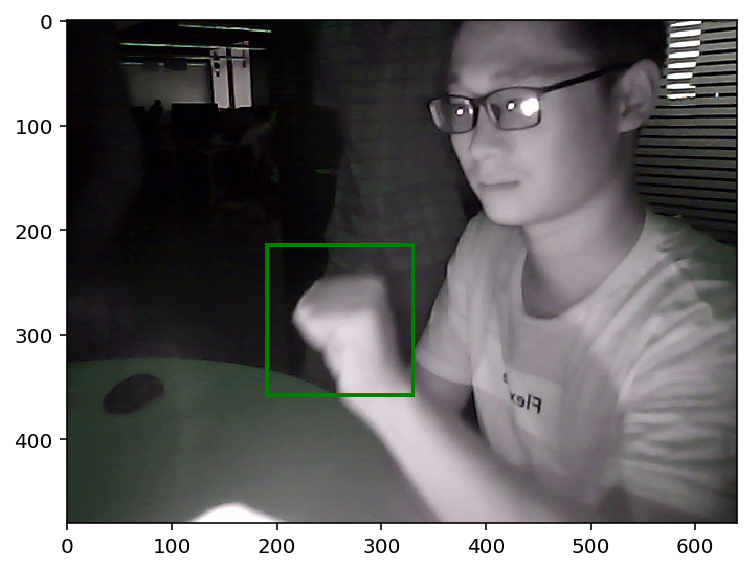

time for one forward pass:  4.986763000488281 ms
predictiing time for one frame:  30.918598175048828 ms


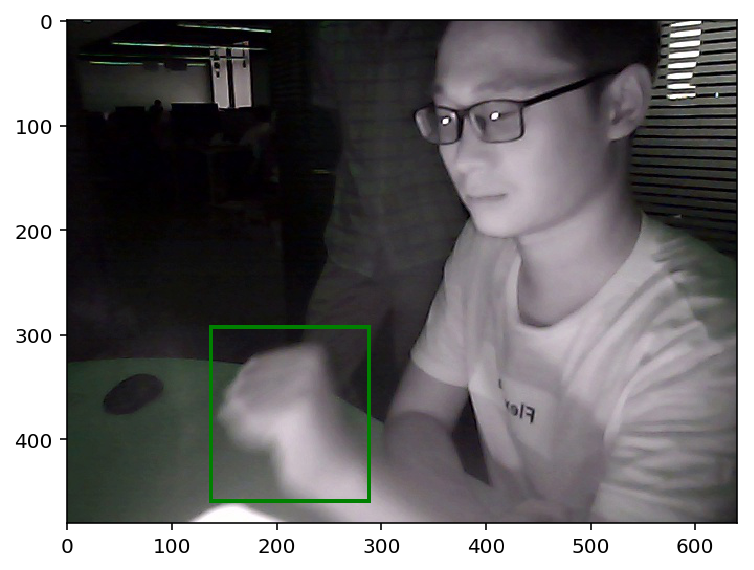

time for one forward pass:  9.974241256713867 ms
predictiing time for one frame:  28.924942016601562 ms


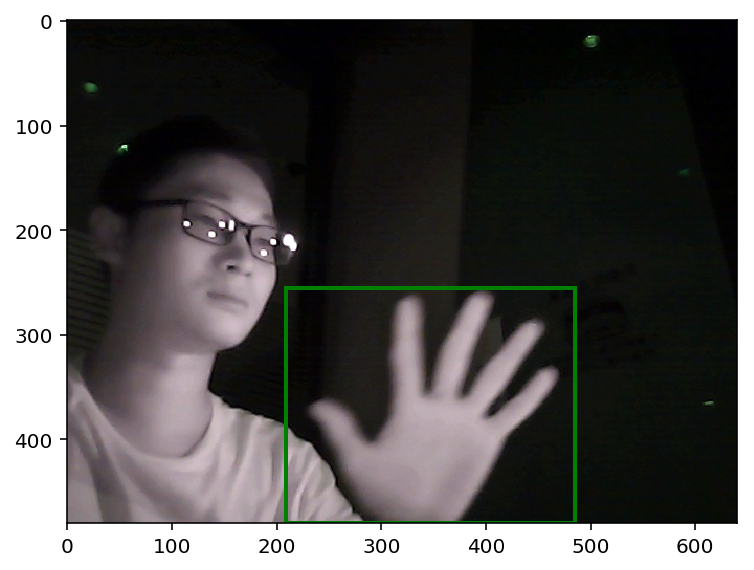

time for one forward pass:  6.982326507568359 ms
predictiing time for one frame:  15.956640243530273 ms


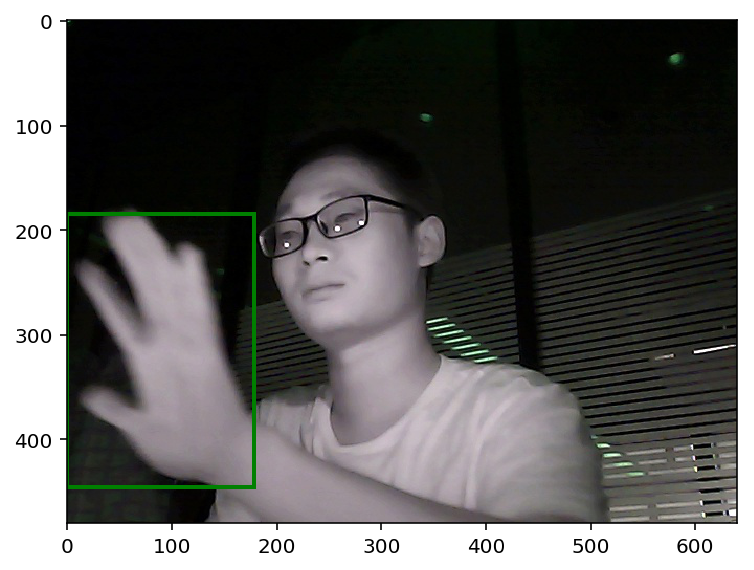

time for one forward pass:  6.978273391723633 ms
predictiing time for one frame:  19.944190979003906 ms


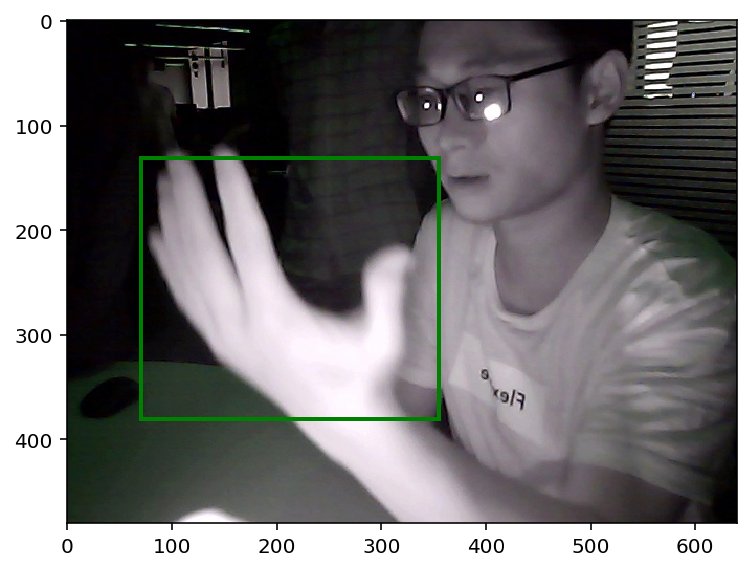

time for one forward pass:  4.993438720703125 ms
predictiing time for one frame:  23.937463760375977 ms


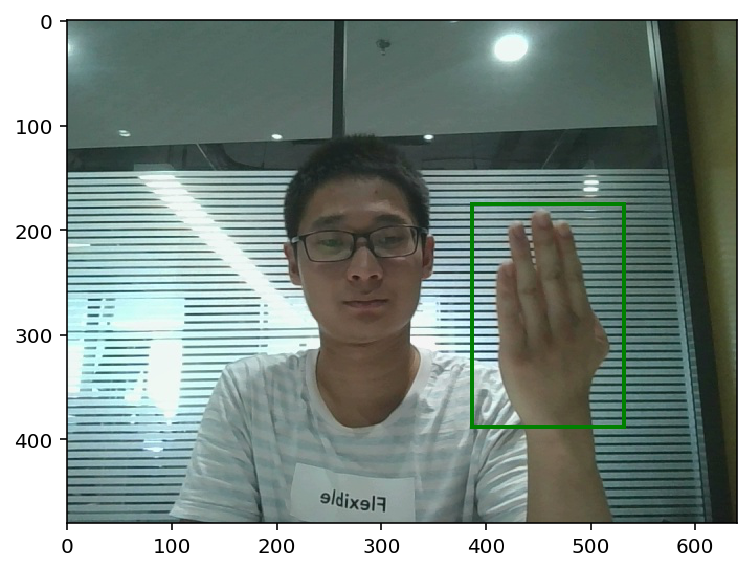

time for one forward pass:  3.9894580841064453 ms
predictiing time for one frame:  20.94411849975586 ms


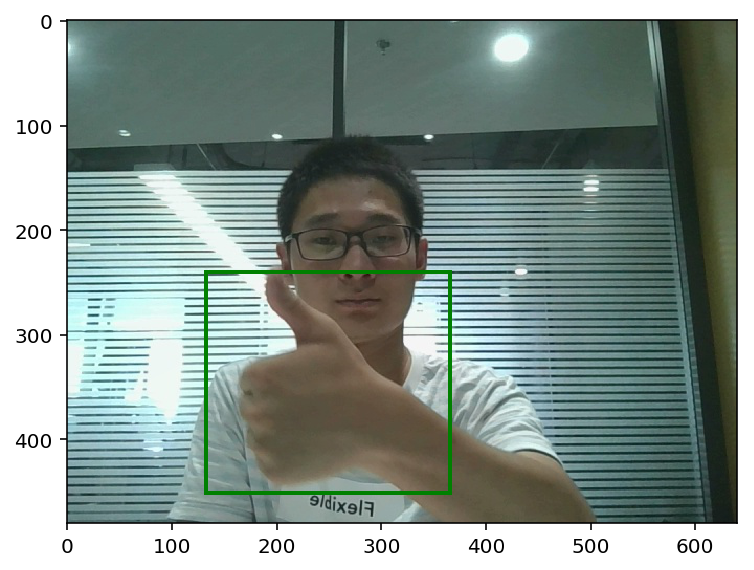

time for one forward pass:  5.983591079711914 ms
predictiing time for one frame:  22.944927215576172 ms


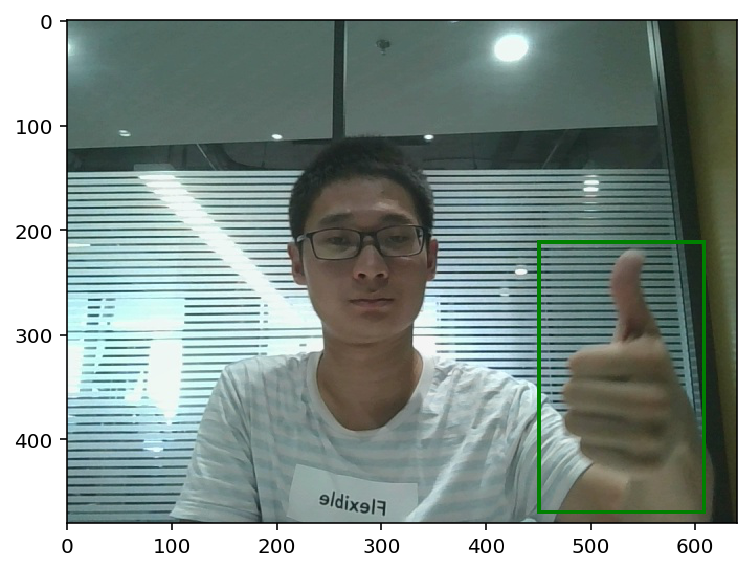

time for one forward pass:  4.987001419067383 ms
predictiing time for one frame:  18.948078155517578 ms


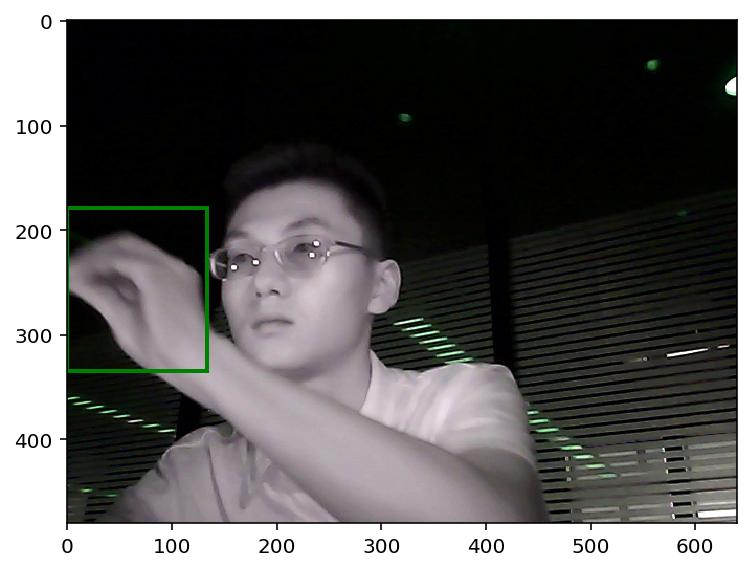

time for one forward pass:  10.970830917358398 ms
predictiing time for one frame:  21.94046974182129 ms


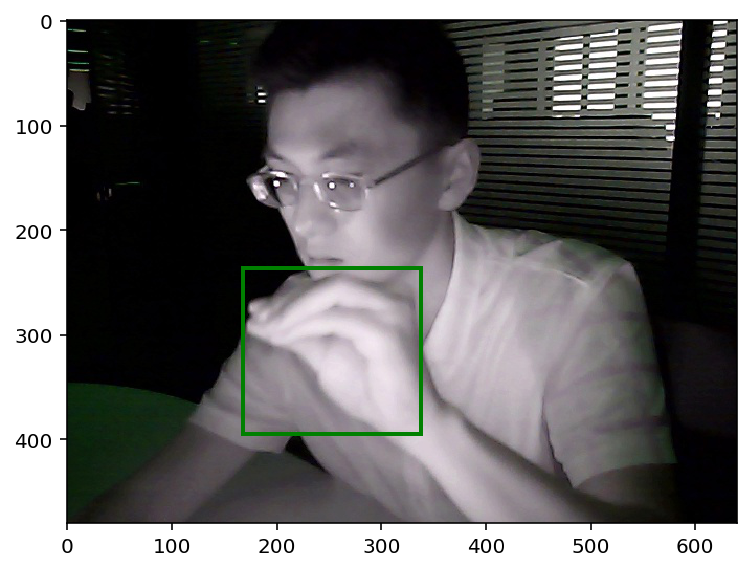

time for one forward pass:  3.9904117584228516 ms
predictiing time for one frame:  22.938013076782227 ms


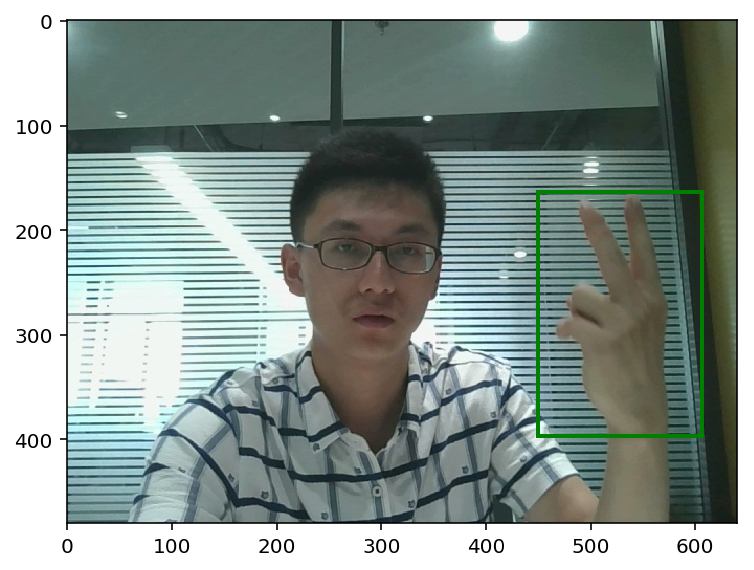

time for one forward pass:  8.976936340332031 ms
predictiing time for one frame:  29.915332794189453 ms


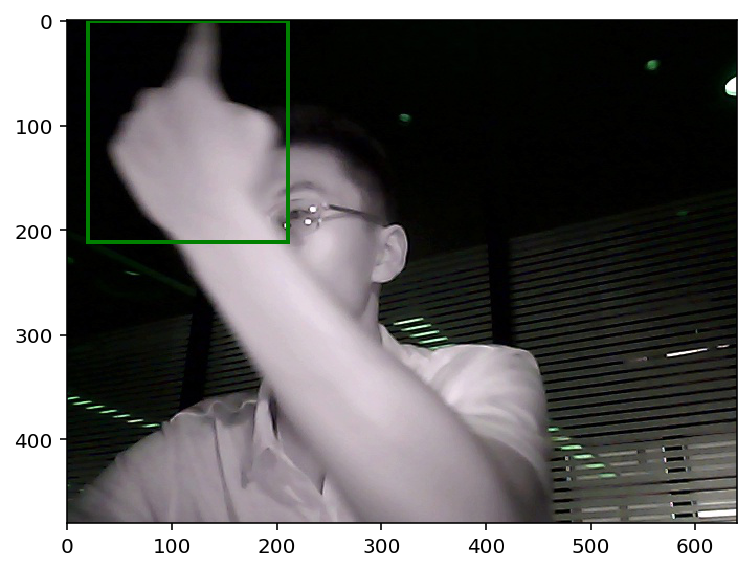

time for one forward pass:  7.98487663269043 ms
predictiing time for one frame:  32.913923263549805 ms


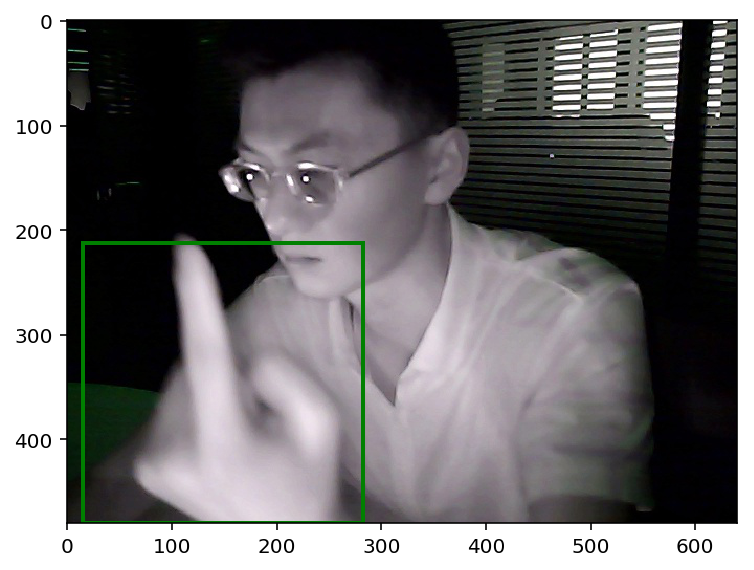

time for one forward pass:  7.978916168212891 ms
predictiing time for one frame:  28.920888900756836 ms


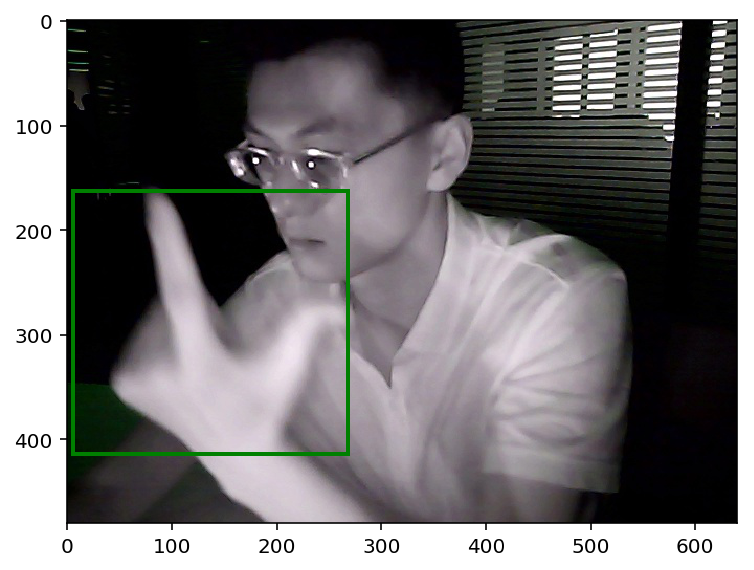

time for one forward pass:  8.976936340332031 ms
predictiing time for one frame:  28.923511505126953 ms


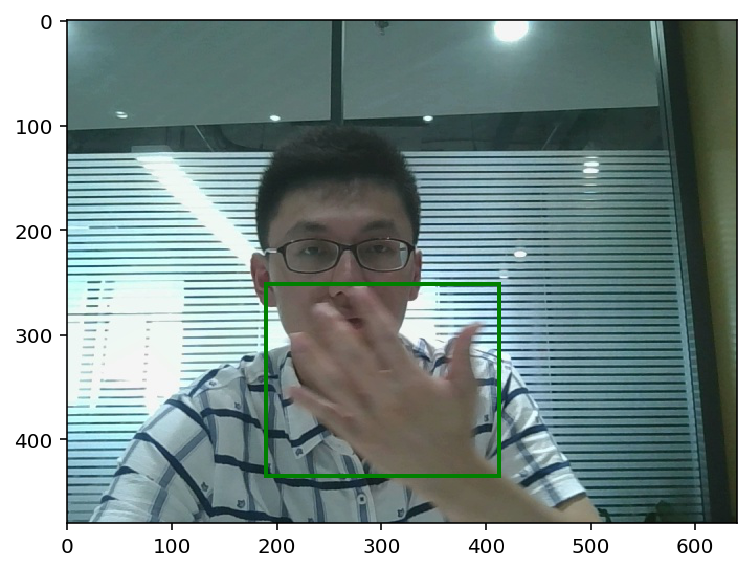

time for one forward pass:  6.979465484619141 ms
predictiing time for one frame:  19.945621490478516 ms


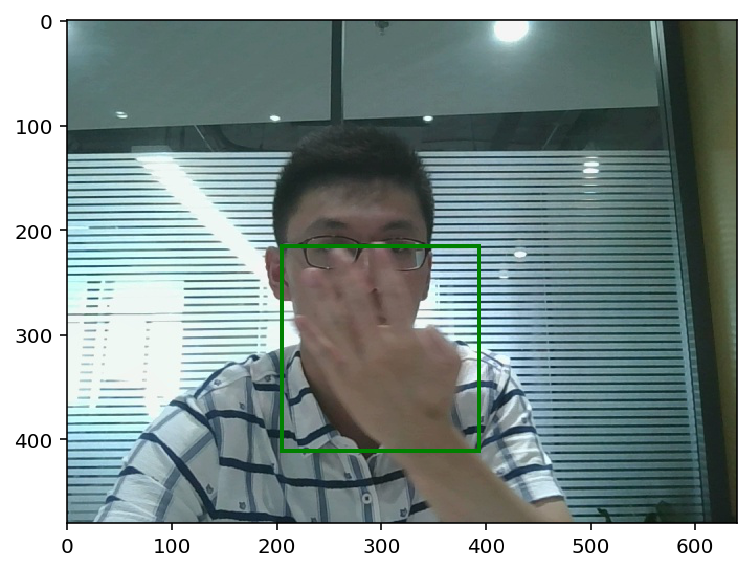

time for one forward pass:  5.980253219604492 ms
predictiing time for one frame:  23.931503295898438 ms


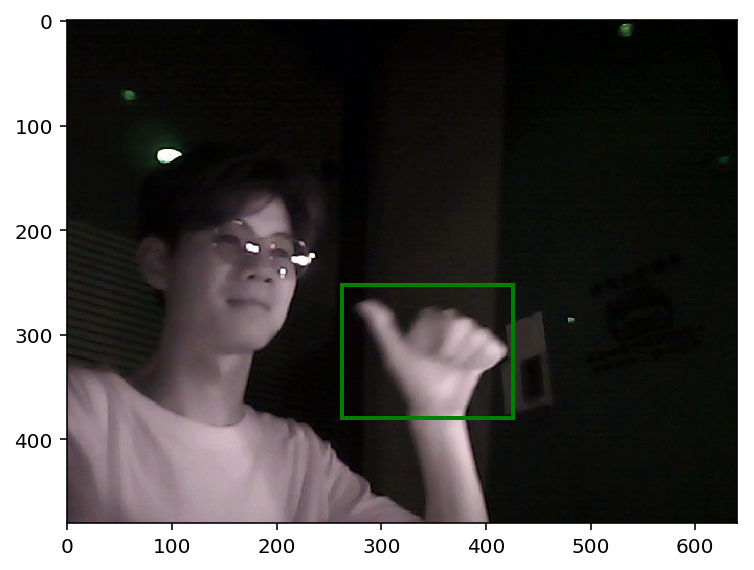

time for one forward pass:  5.986213684082031 ms
predictiing time for one frame:  20.943641662597656 ms


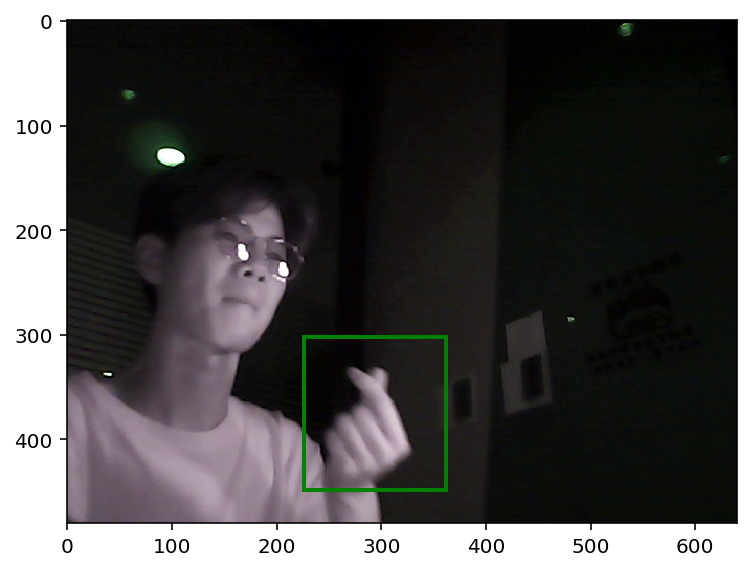

time for one forward pass:  6.981849670410156 ms
predictiing time for one frame:  17.951250076293945 ms


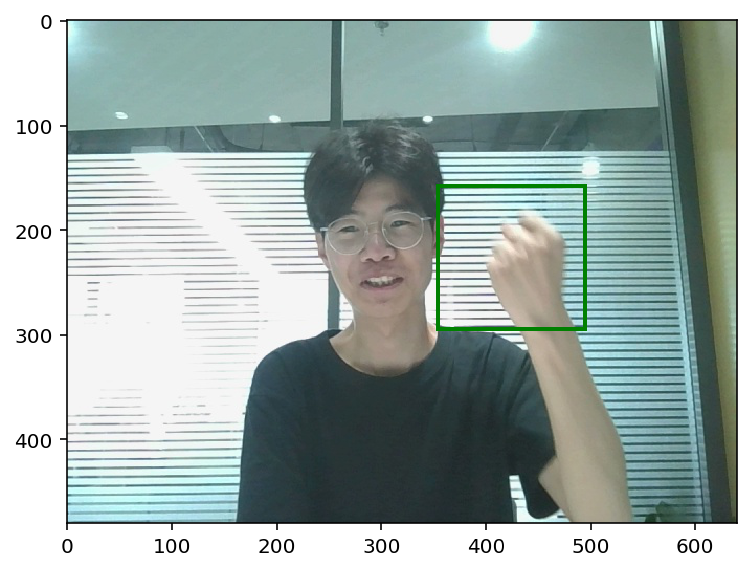

time for one forward pass:  5.984306335449219 ms
predictiing time for one frame:  17.951250076293945 ms


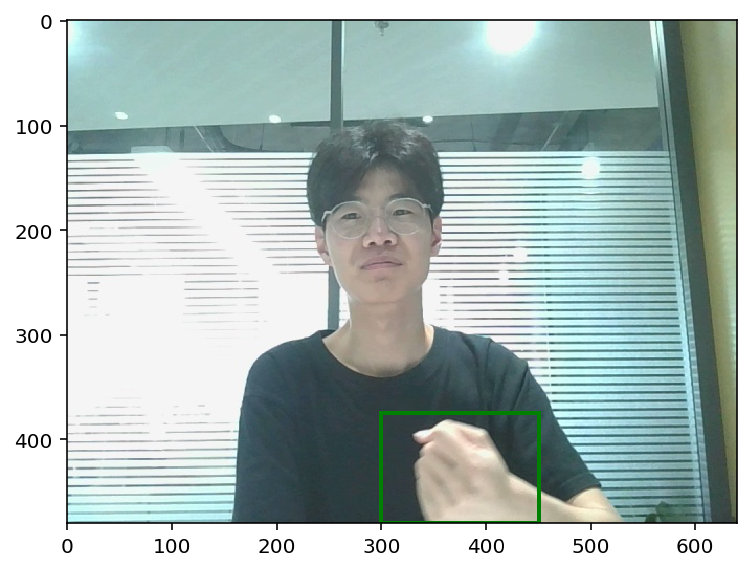

time for one forward pass:  6.983041763305664 ms
predictiing time for one frame:  15.95759391784668 ms


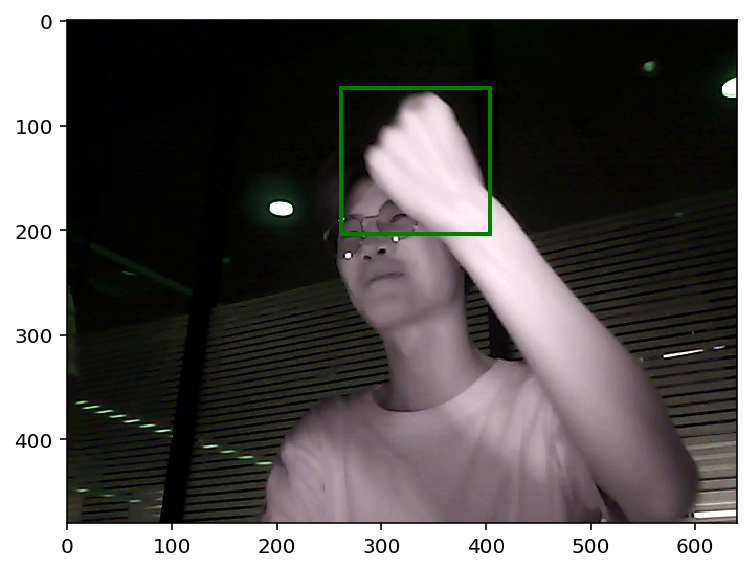

time for one forward pass:  6.98089599609375 ms
predictiing time for one frame:  19.94633674621582 ms


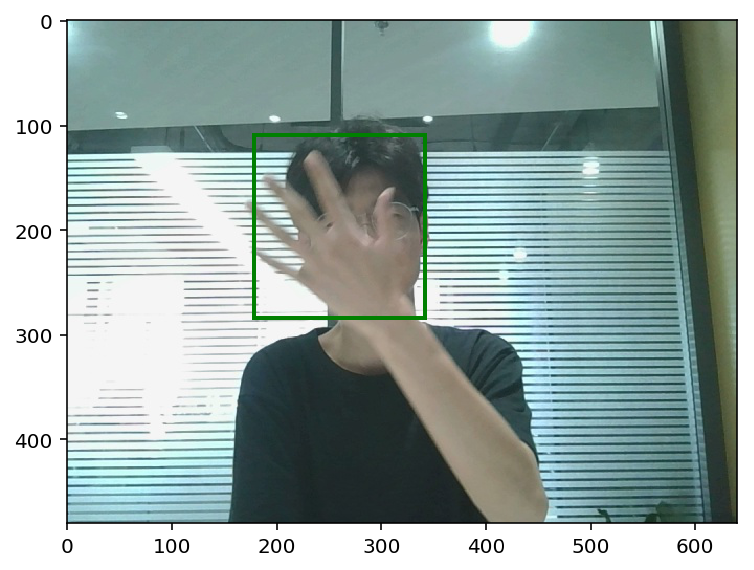

time for one forward pass:  6.982326507568359 ms
predictiing time for one frame:  16.95418357849121 ms


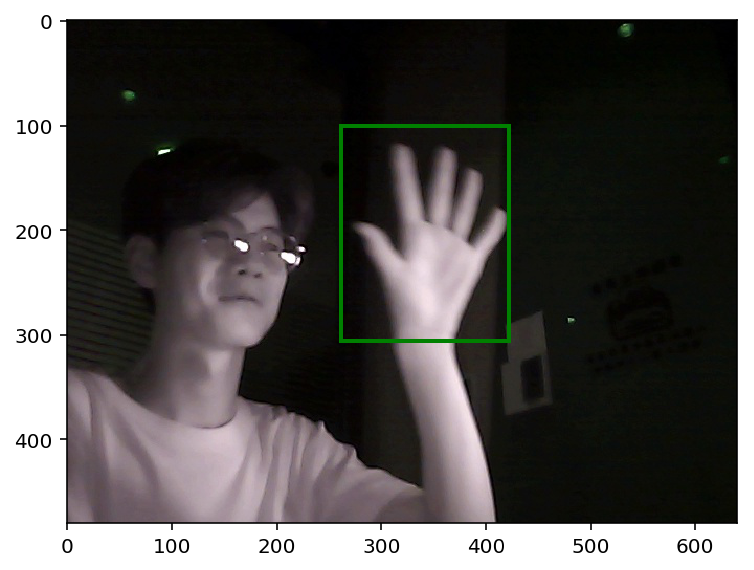

time for one forward pass:  6.982326507568359 ms
predictiing time for one frame:  20.943641662597656 ms


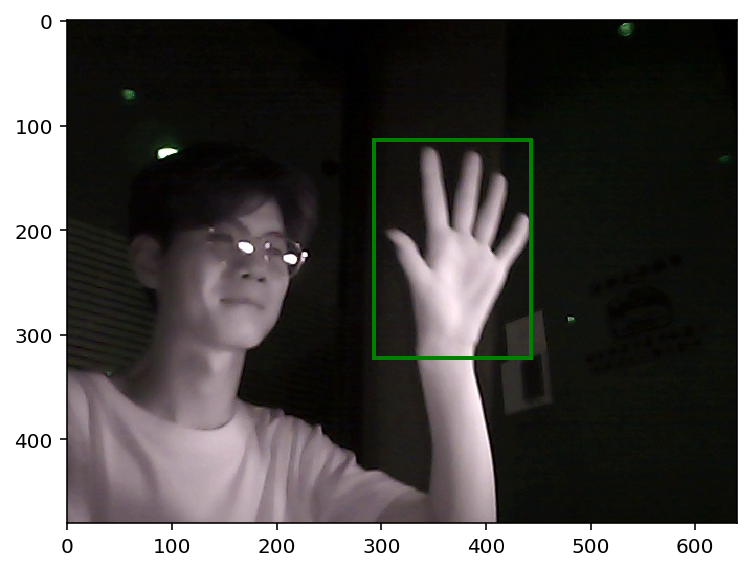

time for one forward pass:  6.987094879150391 ms
predictiing time for one frame:  18.949031829833984 ms


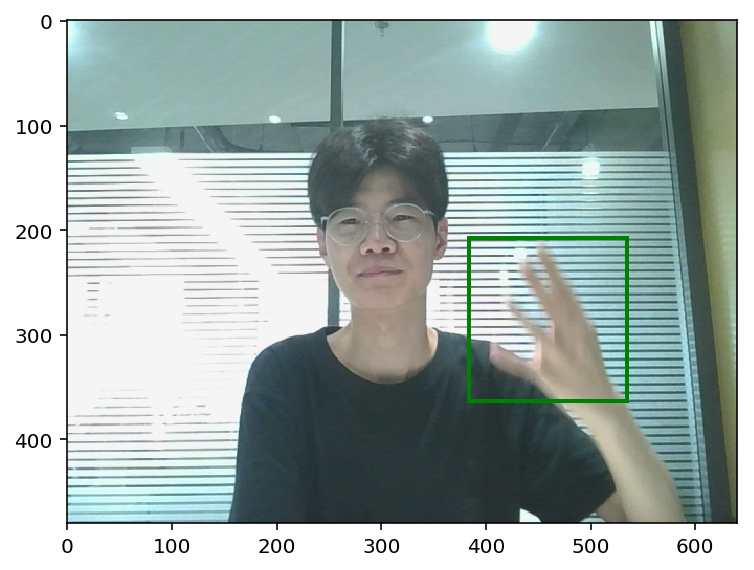

time for one forward pass:  5.985021591186523 ms
predictiing time for one frame:  16.954660415649414 ms


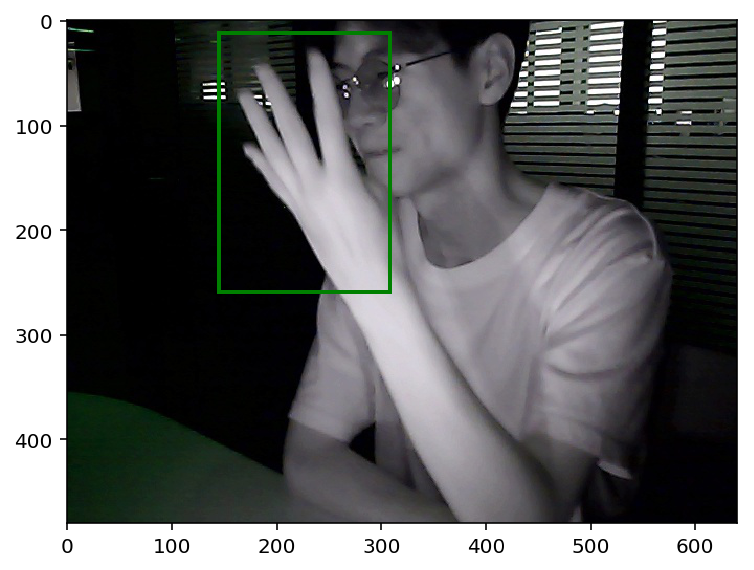

time for one forward pass:  5.985260009765625 ms
predictiing time for one frame:  19.946575164794922 ms


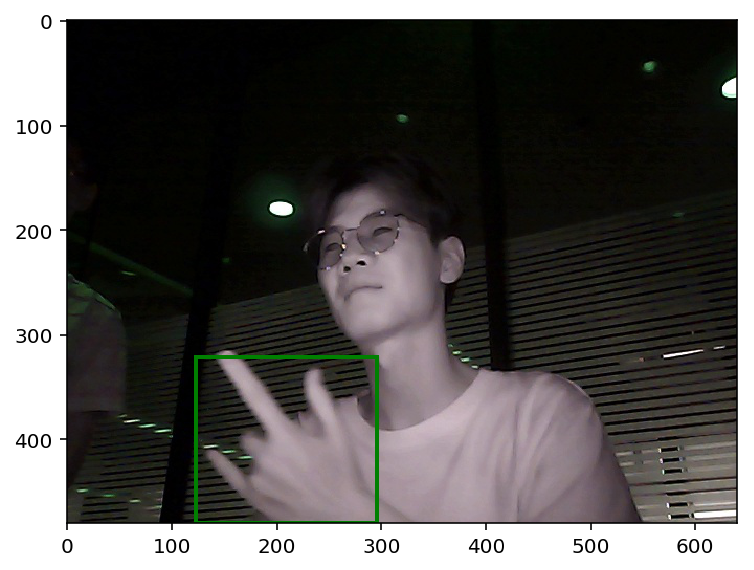

time for one forward pass:  3.9894580841064453 ms
predictiing time for one frame:  24.935007095336914 ms


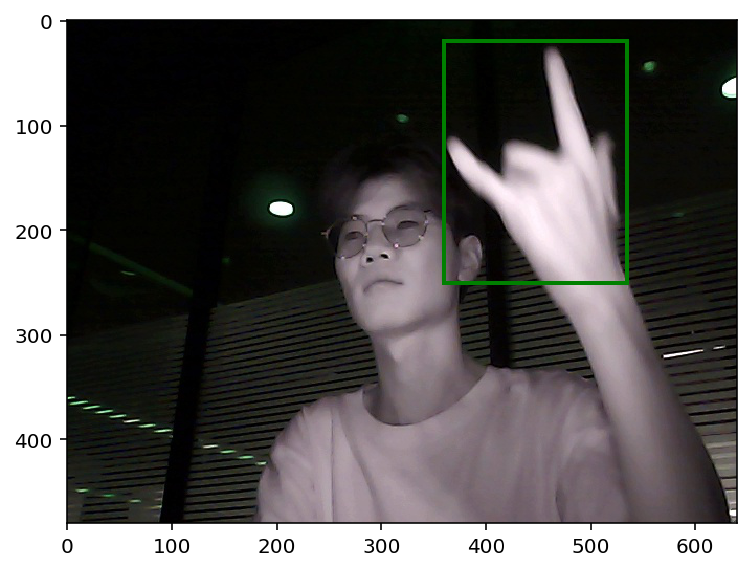

time for one forward pass:  5.984783172607422 ms
predictiing time for one frame:  14.96267318725586 ms


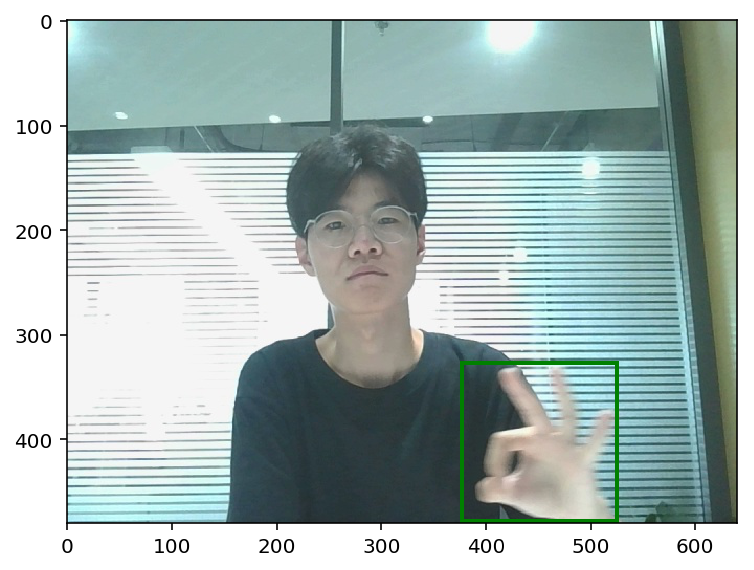

time for one forward pass:  11.967182159423828 ms
predictiing time for one frame:  28.920888900756836 ms


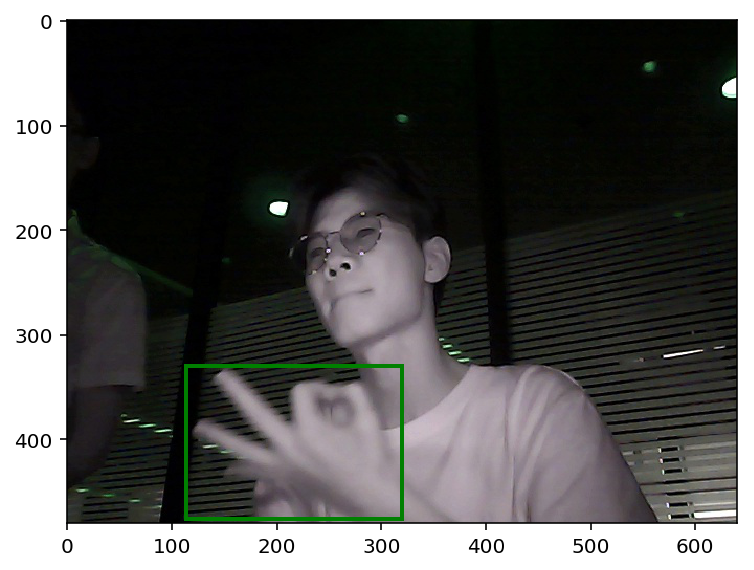

time for one forward pass:  7.977724075317383 ms
predictiing time for one frame:  29.918670654296875 ms


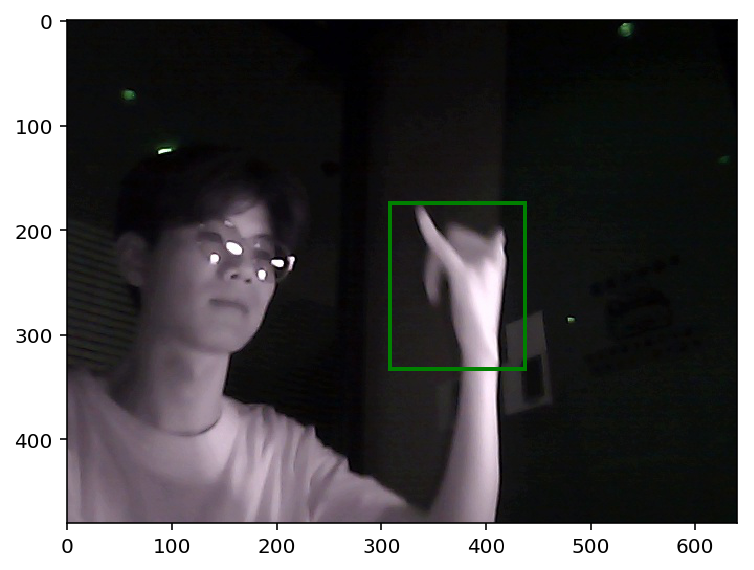

time for one forward pass:  8.983612060546875 ms
predictiing time for one frame:  23.936033248901367 ms


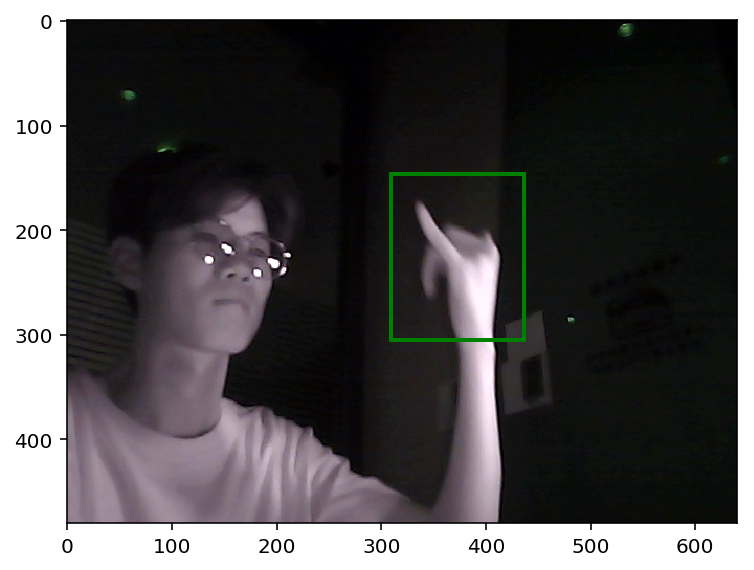

time for one forward pass:  6.981849670410156 ms
predictiing time for one frame:  21.941423416137695 ms


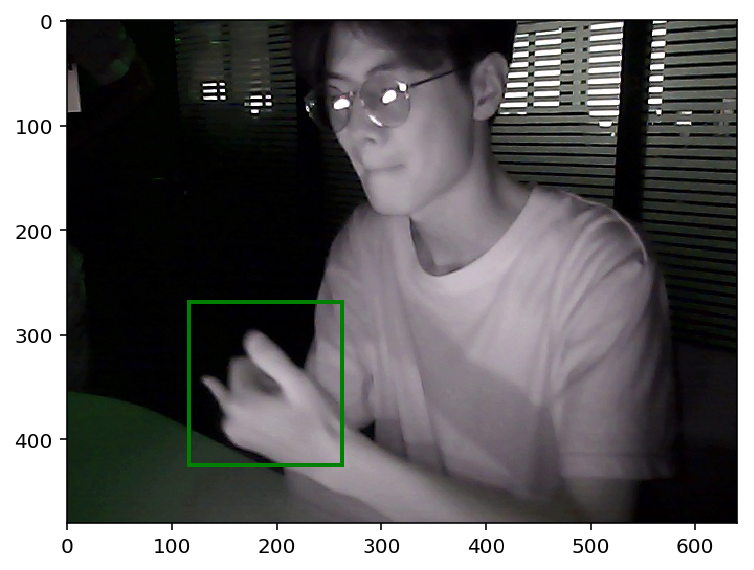

time for one forward pass:  3.988981246948242 ms
predictiing time for one frame:  26.927471160888672 ms


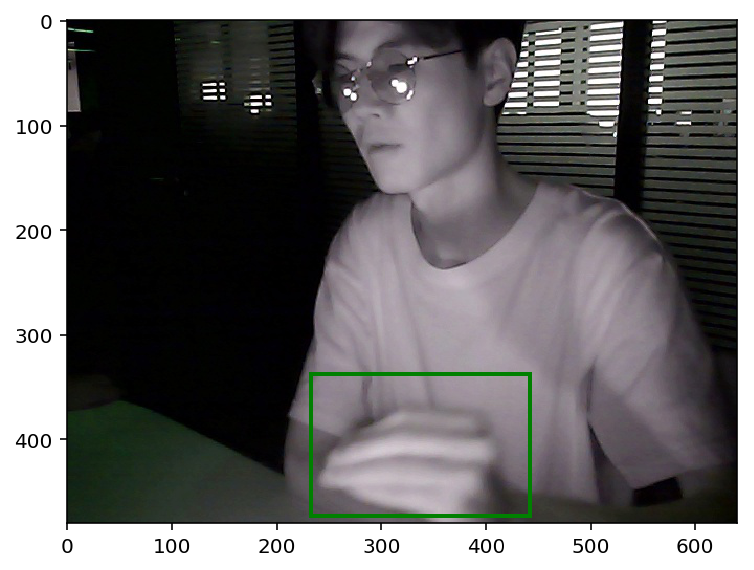

time for one forward pass:  5.984067916870117 ms
predictiing time for one frame:  21.9419002532959 ms


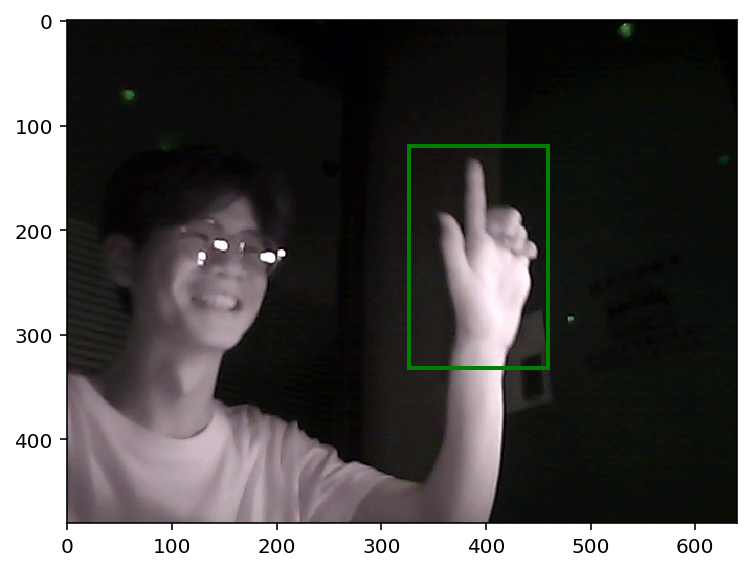

time for one forward pass:  6.981134414672852 ms
predictiing time for one frame:  29.918670654296875 ms


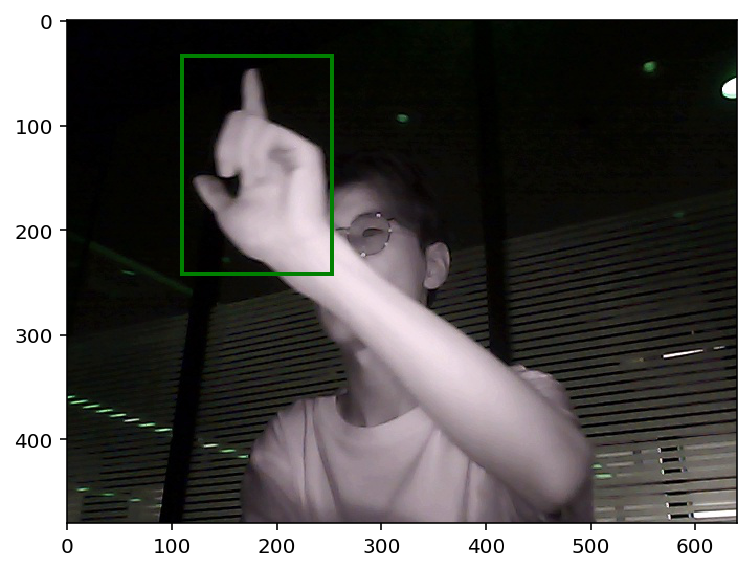

time for one forward pass:  6.98089599609375 ms
predictiing time for one frame:  20.943641662597656 ms


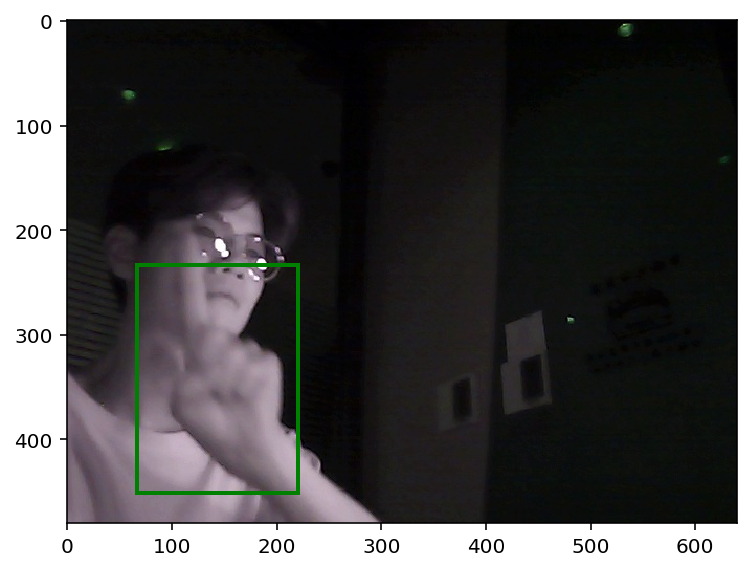

time for one forward pass:  3.9892196655273438 ms
predictiing time for one frame:  23.935556411743164 ms


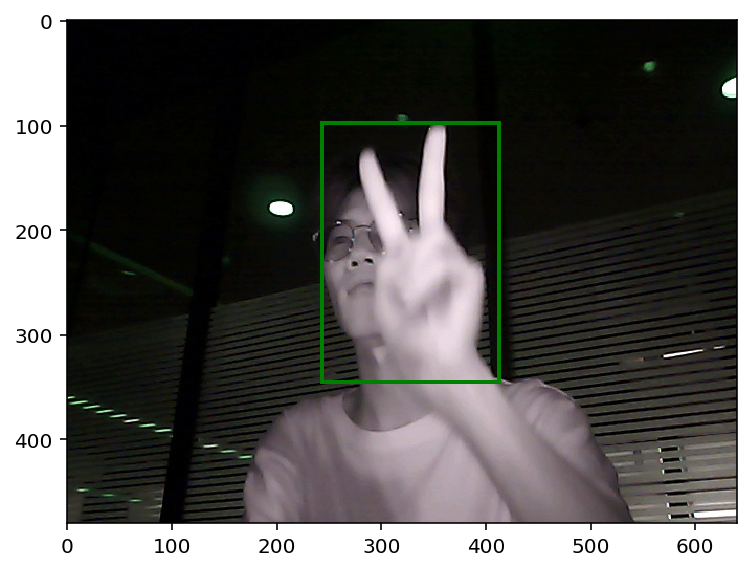

time for one forward pass:  10.978460311889648 ms
predictiing time for one frame:  36.901235580444336 ms


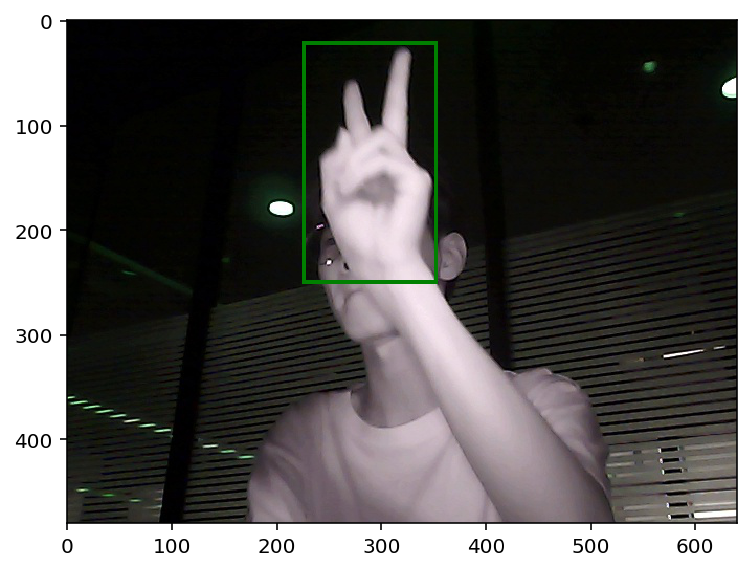

<Figure size 432x432 with 0 Axes>

In [31]:
test_dir = r'D:/Programs/Gluon_Tutorial/Gluon_Yolo_v2/test_images/unseen/'
test_samples = os.listdir(test_dir)

for i in range(len(test_samples)):
    x, im = process_image(test_dir + test_samples[i])   #这里的data是resize之后的，im为原尺寸
    #model = creat_model('D:/Programs/Gluon_Tutorial/Gluon_Yolo_v2/models/origin_epoch_149.params',2,anchor_scales)

    # model = creat_model('D:/Programs/Gluon_Tutorial/Gluon_Yolo_v2/models/anchor_num_3/anchor_num_3_0.params',2,anchor_scales)
    anchor_scales = scales = [[4.0, 4.8],   #每一行表示一个预先选定的bbox形状，第一列为width，第二列为height。【【这里的数值不是在全图上的数值，而是根据网络输出feature map的大小(256/16=16)定的】】
              [4.8, 4.8],
              [5.6, 4.0],
              [4.8, 8.0],
              [6.4, 6.4]]
    model = creat_model('D:/Programs/Gluon_Tutorial/Gluon_Yolo_v2/models/model_saved_5_anchors/anchor_num_3_40.params',2,anchor_scales)

    start_time = time.time()
    out = predict(x.as_in_context(mx.cpu(0)))
    print('predictiing time for one frame: ',(time.time() - start_time)*1000, 'ms')
    # plt.figure()
    # display(im, out[0], threshold=0.1)
    #plt.figure()
    #, 'D:\Programs\Gluon_Tutorial\Gluon_Yolo_v2\predictions\prediction_{}.jpg'.format(i)
    display2(out)

In [239]:
np.array(anchor_scales)/16

array([[0.2 , 0.35],
       [0.25, 0.25],
       [0.35, 0.2 ]])

In [12]:
import mxnet as mx
from mxnet import nd
a = nd.ones((2,16,16,2,1))
b = nd.ones((2,16,16,2,4))
nd.concat(*[a,b], dim = -1).shape

(2, 16, 16, 2, 5)

In [55]:
%matplotlib inline
import cv2
os.chdir('D:/Programs/Linux_Tutorial_II/第二节——批量修改xml中的类别信息/images/')
frame = cv2.imread(r'1533023916.44_seven_view0_036.jpg')
frame = frame[...,::-1]
cv2.imshow('test_frame',frame)

array([[[149, 186, 192],
        [144, 181, 187],
        [139, 174, 180],
        ...,
        [ 88,  97,  78],
        [ 89,  96,  78],
        [ 89,  96,  78]],

       [[149, 186, 192],
        [148, 185, 191],
        [145, 180, 186],
        ...,
        [ 90,  99,  80],
        [ 91,  98,  80],
        [ 92,  99,  81]],

       [[152, 189, 195],
        [150, 187, 193],
        [142, 179, 185],
        ...,
        [ 90,  99,  80],
        [ 89,  98,  79],
        [ 90,  99,  80]],

       ...,

       [[ 83, 117, 126],
        [ 88, 122, 131],
        [ 93, 126, 135],
        ...,
        [ 33,  34,  26],
        [ 35,  37,  26],
        [ 36,  38,  27]],

       [[ 54,  88,  97],
        [ 68, 102, 111],
        [ 80, 114, 123],
        ...,
        [ 31,  34,  25],
        [ 31,  33,  22],
        [ 32,  34,  23]],

       [[ 81, 115, 124],
        [ 88, 122, 131],
        [ 91, 125, 134],
        ...,
        [ 32,  35,  26],
        [ 30,  32,  21],
        [ 30,  32,  21]]

In [138]:
out1[0][0][2:6]

array([0.3024403 , 0.54863137, 0.6215763 , 0.7484351 ], dtype=float32)

In [139]:
np.array([im.shape[1],im.shape[0]]*2)

array([640, 480, 640, 480])

In [185]:
out1[0][0]

array([0.        , 0.99328125, 0.08623624, 0.6913477 , 0.3545195 ,
       0.86653125], dtype=float32)

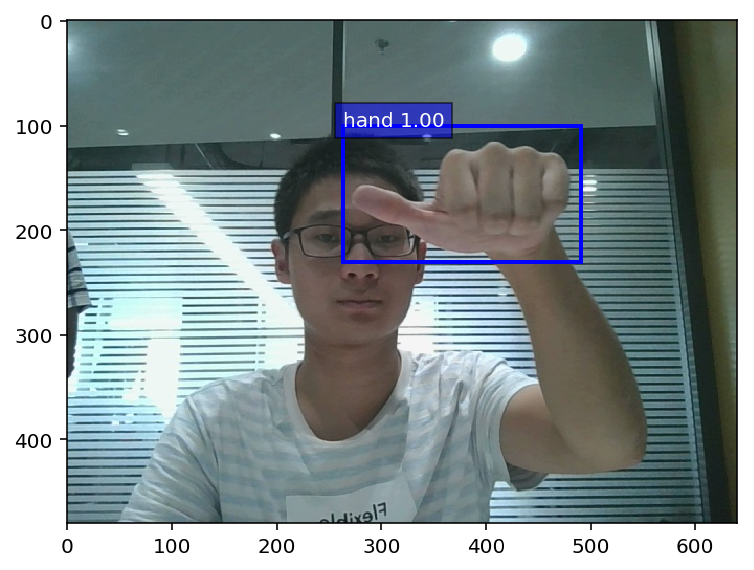

In [30]:
### 显示结果

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (6,6)

colors = ['blue', 'green', 'red', 'black', 'magenta']

def display(im, out, threshold=0.4):
    plt.imshow(im.asnumpy())
    for row in out:
        row = row.asnumpy()
        class_id, score = int(row[0]), row[1]
        if class_id < 0 or score < threshold:
            continue
        color = colors[class_id%len(colors)]
        #pdb.set_trace()
        box = row[2:6] * np.array([im.shape[1],im.shape[0]]*2)
        rect = box_to_rect(nd.array(box), color, 2)
        plt.gca().add_patch(rect)
        text = class_names[class_id]
        plt.gca().text(box[0], box[1],
                       '{:s} {:.2f}'.format(text, score),
                       bbox=dict(facecolor=color, alpha=0.5),
                       fontsize=10, color='white')
    plt.show()
def display2(out, save_name=None):
    out1 = out.asnumpy()
    box = out1[0][0][2:6] * np.array([im.shape[1],im.shape[0]]*2)
    rect = box_to_rect(nd.array(box), 'green', 2)
    plt.imshow(im.asnumpy())
    plt.gca().add_patch(rect)
    if save_name is None:
        plt.show()
    else:
        plt.savefig(save_name)
    plt.clf()
display(im, out[0], threshold=0.1)

实验室

In [22]:
t1 = nd.transpose(test_output,[0,2,3,1])
t1.reshape((0,0,0,-1,stride))

(16, 16, 16, 14)